# Определение перспективного тарифа для телеком компании

[Шаг 1. Изучение общей информации](#Шаг-1.-Изучение-общей-информации)

[Шаг 2. Подготовка данных](#Шаг-2.-Подготовка-данных)

[Шаг 3. Анализ данных](#Шаг-3.-Анализ-данных)

[Шаг 4. Проверка гипотез](#Шаг-4.-Проверка-гипотез)

[Шаг 5. Общий вывод](#Шаг-5.-Общий-вывод)

# Шаг 1. Изучение общей информации 

In [1]:
import pandas as pd
calls = pd.read_csv('/datasets/calls.csv')
print(calls)
print(calls.info())
print('==============================')
internet = pd.read_csv('/datasets/internet.csv') 
print(internet)
print(internet.info())
print('==============================')
messages = pd.read_csv('/datasets/messages.csv') 
print(messages)
print(messages.info())
print('==============================')
tariffs = pd.read_csv('/datasets/tariffs.csv') 
tariffs['rub_per_mb'] = tariffs['rub_per_gb']/1024 # Для удобства переведем стоимость за гигабайт в стоимость за мегабайт
print(tariffs)
print(tariffs.info())
print('==============================')
users = pd.read_csv('/datasets/users.csv') 
print(users)
print(users.info())
def info(df): #Функция пробегает по признакам датафрейма и если тип у признака object, то смотрит уникальные значения, в противном случае оценивается распределение
    for column in df.columns:
        
        print(df[column].describe())
        print()
    
        if df[column].dtype == 'object':
            
            print(column)
            print(df[column].unique())
                    
        else:
            
            print(column)
            import plotly.express as px
            fig = px.histogram(df, x = column, marginal = 'box', title = 'Распределение '+ column)
            fig.show()
            
info(users)
info(calls)
info(messages)
info(internet)
info(tariffs)

              id   call_date  duration  user_id
0         1000_0  2018-07-25      0.00     1000
1         1000_1  2018-08-17      0.00     1000
2         1000_2  2018-06-11      2.85     1000
3         1000_3  2018-09-21     13.80     1000
4         1000_4  2018-12-15      5.18     1000
...          ...         ...       ...      ...
202602  1499_215  2018-12-26      0.76     1499
202603  1499_216  2018-10-18     18.83     1499
202604  1499_217  2018-11-10     10.81     1499
202605  1499_218  2018-10-06      4.27     1499
202606  1499_219  2018-12-14     19.62     1499

[202607 rows x 4 columns]
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 202607 entries, 0 to 202606
Data columns (total 4 columns):
id           202607 non-null object
call_date    202607 non-null object
duration     202607 non-null float64
user_id      202607 non-null int64
dtypes: float64(1), int64(1), object(2)
memory usage: 6.2+ MB
None
        Unnamed: 0        id  mb_used session_date  user_id
0               

count    500.00000
mean      46.58800
std       16.66763
min       18.00000
25%       32.00000
50%       46.00000
75%       62.00000
max       75.00000
Name: age, dtype: float64

age


count             38
unique            33
top       2018-12-09
freq               2
Name: churn_date, dtype: object

churn_date
[nan '2018-10-05' '2018-12-18' '2018-11-21' '2018-10-03' '2018-10-14'
 '2018-12-09' '2018-12-11' '2018-12-26' '2018-08-31' '2018-12-03'
 '2018-12-23' '2018-11-07' '2018-12-16' '2018-12-20' '2018-11-30'
 '2018-12-21' '2018-08-17' '2018-09-02' '2018-10-04' '2018-11-13'
 '2018-11-22' '2018-10-28' '2018-11-26' '2018-11-27' '2018-11-16'
 '2018-10-27' '2018-12-30' '2018-09-27' '2018-12-25' '2018-12-14'
 '2018-12-24' '2018-09-26' '2018-10-25']
count        500
unique        76
top       Москва
freq          99
Name: city, dtype: object

city
['Краснодар' 'Москва' 'Стерлитамак' 'Новокузнецк' 'Набережные Челны'
 'Ульяновск' 'Челябинск' 'Пермь' 'Тюмень' 'Самара' 'Санкт-Петербург'
 'Иваново' 'Чебоксары' 'Омск' 'Уфа' 'Томск' 'Чита' 'Мурманск'
 'Петрозаводск' 'Тверь' 'Екатеринбург' 'Махачкала' 'Вологда' 'Череповец'
 'Ярославль' 'Сочи' 'Хабаровск' 'Ставрополь' 'Рязань' 'Ула

count    202607.000000
mean       1253.940619
std         144.722751
min        1000.000000
25%        1126.000000
50%        1260.000000
75%        1379.000000
max        1499.000000
Name: user_id, dtype: float64

user_id


count       123036
unique      123036
top       1375_751
freq             1
Name: id, dtype: object

id
['1000_0' '1000_1' '1000_2' ... '1499_181' '1499_182' '1499_183']
count         123036
unique           364
top       2018-12-31
freq             859
Name: message_date, dtype: object

message_date
['2018-06-27' '2018-10-08' '2018-08-04' '2018-06-16' '2018-12-05'
 '2018-06-20' '2018-11-19' '2018-10-29' '2018-06-25' '2018-12-18'
 '2018-05-30' '2018-07-06' '2018-08-20' '2018-10-30' '2018-09-14'
 '2018-08-28' '2018-06-29' '2018-07-07' '2018-05-29' '2018-05-28'
 '2018-08-15' '2018-07-29' '2018-12-07' '2018-12-25' '2018-10-31'
 '2018-07-30' '2018-11-05' '2018-12-15' '2018-12-04' '2018-06-30'
 '2018-12-22' '2018-10-02' '2018-08-29' '2018-09-09' '2018-07-19'
 '2018-09-04' '2018-07-15' '2018-10-25' '2018-12-08' '2018-06-01'
 '2018-06-12' '2018-12-21' '2018-10-07' '2018-08-30' '2018-06-04'
 '2018-10-01' '2018-06-22' '2018-10-12' '2018-10-15' '2018-10-24'
 '2018-09-20' '2018-08-22' '2018-09-17

count    149396.000000
mean      74697.500000
std       43127.054745
min           0.000000
25%       37348.750000
50%       74697.500000
75%      112046.250000
max      149395.000000
Name: Unnamed: 0, dtype: float64

Unnamed: 0


count       149396
unique      149396
top       1403_323
freq             1
Name: id, dtype: object

id
['1000_0' '1000_1' '1000_2' ... '1499_154' '1499_155' '1499_156']
count    149396.000000
mean        370.192426
std         278.300951
min           0.000000
25%         138.187500
50%         348.015000
75%         559.552500
max        1724.830000
Name: mb_used, dtype: float64

mb_used


count         149396
unique           365
top       2018-12-31
freq            1057
Name: session_date, dtype: object

session_date
['2018-11-25' '2018-09-07' '2018-06-25' '2018-08-22' '2018-09-24'
 '2018-10-02' '2018-07-11' '2018-10-08' '2018-09-03' '2018-09-27'
 '2018-08-28' '2018-06-20' '2018-08-09' '2018-08-11' '2018-07-21'
 '2018-06-09' '2018-06-03' '2018-11-01' '2018-11-28' '2018-08-20'
 '2018-12-06' '2018-07-02' '2018-10-19' '2018-10-30' '2018-06-17'
 '2018-11-06' '2018-09-14' '2018-11-15' '2018-08-26' '2018-10-15'
 '2018-11-27' '2018-10-17' '2018-10-07' '2018-08-05' '2018-07-06'
 '2018-10-03' '2018-11-02' '2018-06-30' '2018-11-17' '2018-06-06'
 '2018-11-20' '2018-05-31' '2018-10-29' '2018-12-10' '2018-07-04'
 '2018-12-28' '2018-05-28' '2018-09-15' '2018-09-09' '2018-09-17'
 '2018-09-01' '2018-11-03' '2018-11-04' '2018-06-16' '2018-12-07'
 '2018-08-25' '2018-06-15' '2018-06-26' '2018-10-06' '2018-12-01'
 '2018-10-14' '2018-06-07' '2018-12-15' '2018-10-04' '2018-08-13'
 '2018-07-

count       2.000000
mean      525.000000
std       671.751442
min        50.000000
25%       287.500000
50%       525.000000
75%       762.500000
max      1000.000000
Name: messages_included, dtype: float64

messages_included


count        2.000000
mean     23040.000000
std      10861.160159
min      15360.000000
25%      19200.000000
50%      23040.000000
75%      26880.000000
max      30720.000000
Name: mb_per_month_included, dtype: float64

mb_per_month_included


count       2.000000
mean     1750.000000
std      1767.766953
min       500.000000
25%      1125.000000
50%      1750.000000
75%      2375.000000
max      3000.000000
Name: minutes_included, dtype: float64

minutes_included


count       2.000000
mean     1250.000000
std       989.949494
min       550.000000
25%       900.000000
50%      1250.000000
75%      1600.000000
max      1950.000000
Name: rub_monthly_fee, dtype: float64

rub_monthly_fee


count      2.000000
mean     175.000000
std       35.355339
min      150.000000
25%      162.500000
50%      175.000000
75%      187.500000
max      200.000000
Name: rub_per_gb, dtype: float64

rub_per_gb


count    2.000000
mean     2.000000
std      1.414214
min      1.000000
25%      1.500000
50%      2.000000
75%      2.500000
max      3.000000
Name: rub_per_message, dtype: float64

rub_per_message


count    2.000000
mean     2.000000
std      1.414214
min      1.000000
25%      1.500000
50%      2.000000
75%      2.500000
max      3.000000
Name: rub_per_minute, dtype: float64

rub_per_minute


count         2
unique        2
top       ultra
freq          1
Name: tariff_name, dtype: object

tariff_name
['smart' 'ultra']
count    2.000000
mean     0.170898
std      0.034527
min      0.146484
25%      0.158691
50%      0.170898
75%      0.183105
max      0.195312
Name: rub_per_mb, dtype: float64

rub_per_mb


### Вывод 

* Таблица users открыта и изучена. Таблица имеет 500 строк и 8 столбцов. 
* Таблица tariffs открыта и изучена. Таблица имеет 2 строки и 8 столбцов.
* Таблица messages открыта и изучена. Таблица имеет 123036 строк и 3 столбца.
* Таблица internet открыта и изучена. Таблица имеет 149396 строк и 5 столбцов.
* Таблица calls открыта и изучена. Таблица имеет 202607 строк и 4 столбца.

Использовали describe() и unique() для категориальных переменных, что позволило нам оценить распределение некоторых признаков и увидеть аномалии.

#  Шаг 2. Подготовка данных

#### Приведение данных к нужным типам. Поиск и исправление ошибок в данных. 

In [2]:
calls['call_date_datetime'] = pd.to_datetime(calls['call_date'], format='%Y-%m-%d') # Создали столбец, где привели дату публикации объявления к нужному формату
calls['calls_month'] = pd.DatetimeIndex(calls['call_date']).month # Получили месяц
# ==============================
users['reg_date_datetime'] = pd.to_datetime(users['reg_date'], format='%Y-%m-%d') # Создали столбец, где привели дату публикации объявления к нужному формату
users['reg_date_month'] = pd.DatetimeIndex(users['reg_date']).month # Получили месяц
# ==============================
users['churn_date_datetime'] = pd.to_datetime(users['churn_date'], format='%Y-%m-%d') # Создали столбец, где привели дату публикации объявления к нужному формату
users['churn_date_month'] = pd.DatetimeIndex(users['churn_date']).month # Получили месяц
# ==============================
internet['session_date_datetime'] = pd.to_datetime(internet['session_date'], format='%Y-%m-%d') # Создали столбец, где привели дату публикации объявления к нужному формату
internet['session_date_month'] = pd.DatetimeIndex(internet['session_date']).month # Получили месяц
# ==============================
messages['message_date_datetime'] = pd.to_datetime(messages['message_date'], format='%Y-%m-%d') # Создали столбец, где привели дату публикации объявления к нужному формату
messages['message_date_month'] = pd.DatetimeIndex(messages['message_date']).month # Получили месяц

In [3]:
users_with_tariffs = users.join(tariffs.set_index('tariff_name'), on='tariff', how='outer') # Объединяем таблицы по столбцу 'tariff'

call_me_maybe = users_with_tariffs.join(calls.set_index('user_id'), on='user_id', how='outer') # Объединяем таблицы по столбцу 'user_id'

call_me_maybe_by_user = call_me_maybe.groupby(['user_id', 'calls_month']).agg({'duration': 'sum'}) #Подсчитано количество израсходованных минут разговора по месяцам
calls_count_bymonth = call_me_maybe.groupby(['user_id', 'calls_month']).agg({'duration': 'count'}) #Подсчитано количество сделанных звонков по месяцам
print(calls_count_bymonth)
calls_count = call_me_maybe.groupby(['user_id']).agg({'duration': 'count'}) #Подсчитано количество сделанных звонков за год
print(calls_count)
sms_me_maybe = users_with_tariffs.join(messages.set_index('user_id'), on='user_id', how='outer') # Объединяем таблицы по столбцу 'user_id'

sms_me_maybe_by_user = sms_me_maybe.groupby(['user_id', 'message_date_month']).agg({'id': 'count'}) #Подсчитано количество отправленных сообщений по месяцам
sms_count = sms_me_maybe.groupby(['user_id']).agg({'id': 'count'}) #Подсчитано количество отправленных сообщений за год
print(sms_count)
internet_maybe = users_with_tariffs.join(internet.set_index('user_id'), on='user_id', how='outer') # Объединяем таблицы по столбцу 'user_id'

internet_maybe_by_user = internet_maybe.groupby(['user_id', 'session_date_month']).agg({'mb_used': 'sum'}) #Подсчитан объем израсходованного интернет-трафика по месяцам

my_big_data = call_me_maybe_by_user.join([sms_me_maybe_by_user, internet_maybe_by_user]) # Объединяем таблицы 
my_big_data.reset_index(inplace=True)
my_big_data = my_big_data.join(users.set_index('user_id'), on='user_id', how='outer') # Объединяем таблицы по столбцу 'user_id'
my_big_data = my_big_data.join(tariffs.set_index('tariff_name'), on='tariff', how='outer') # Объединяем таблицы по столбцу 'tariff'

my_big_data = my_big_data.fillna(0) # Заменяем пропущенные значения на 0

my_big_data = my_big_data.rename(columns={"id": "sms", "calls_month": "month"}) # Переименуем некоторые столбцы

display(my_big_data.head(10))
import numpy as np
my_big_data['duration'] = np.ceil(my_big_data['duration']) # Округлим звонки в бОльшую сторону
my_big_data['mb_used'] = np.ceil(my_big_data['mb_used'])# Округлим мегабайты в бОльшую сторону

display(my_big_data.head(10))

                     duration
user_id calls_month          
1000    5.0                22
        6.0                43
        7.0                47
        8.0                52
        9.0                58
...                       ...
1498    10.0               41
1499    9.0                 9
        10.0               68
        11.0               74
        12.0               69

[3174 rows x 1 columns]
         duration
user_id          
1000          368
1001          122
1002          217
1003          520
1004          176
...           ...
1495          565
1496          828
1497          201
1498          180
1499          220

[500 rows x 1 columns]
           id
user_id      
1000      496
1001        0
1002       70
1003      380
1004     1192
...       ...
1495      340
1496      468
1497       51
1498      168
1499      184

[500 rows x 1 columns]


,user_id,month,duration,sms,mb_used,age,churn_date,city,first_name,last_name,...,churn_date_datetime,churn_date_month,messages_included,mb_per_month_included,minutes_included,rub_monthly_fee,rub_per_gb,rub_per_message,rub_per_minute,rub_per_mb
0.0,1000,5.0,150.06,22.0,2253.49,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
1.0,1000,6.0,158.90,60.0,23233.77,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
2.0,1000,7.0,318.80,75.0,14003.64,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
3.0,1000,8.0,389.87,81.0,14055.93,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
4.0,1000,9.0,440.14,57.0,14568.91,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
5.0,1000,10.0,328.45,73.0,14702.49,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
6.0,1000,11.0,319.04,58.0,14756.47,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
7.0,1000,12.0,312.98,70.0,9817.61,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
17.0,1003,8.0,355.67,37.0,8565.21,23,0,Москва,Белла,Белякова,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
18.0,1003,9.0,904.89,91.0,12468.87,23,0,Москва,Белла,Белякова,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484


,user_id,month,duration,sms,mb_used,age,churn_date,city,first_name,last_name,...,churn_date_datetime,churn_date_month,messages_included,mb_per_month_included,minutes_included,rub_monthly_fee,rub_per_gb,rub_per_message,rub_per_minute,rub_per_mb
0.0,1000,5.0,151.0,22.0,2254.0,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
1.0,1000,6.0,159.0,60.0,23234.0,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
2.0,1000,7.0,319.0,75.0,14004.0,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
3.0,1000,8.0,390.0,81.0,14056.0,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
4.0,1000,9.0,441.0,57.0,14569.0,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
5.0,1000,10.0,329.0,73.0,14703.0,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
6.0,1000,11.0,320.0,58.0,14757.0,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
7.0,1000,12.0,313.0,70.0,9818.0,52,0,Краснодар,Рафаил,Верещагин,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
17.0,1003,8.0,356.0,37.0,8566.0,23,0,Москва,Белла,Белякова,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484
18.0,1003,9.0,905.0,91.0,12469.0,23,0,Москва,Белла,Белякова,...,0,0.0,1000,30720,3000,1950,150,1,1,0.146484


####  Расчёт для каждого пользователя:
- количества сделанных звонков и израсходованных минут разговора по месяцам;
- количества отправленных сообщений по месяцам;
- объема израсходованного интернет-трафика по месяцам;
- помесячной выручки с каждого пользователя.

In [4]:
def casher(row): #Создаём функцию, которая подсчитывает помесячную выручку с каждого пользователя
    monthly_cash = row['rub_monthly_fee'] # Сохраним в переменной абонентскую плату, соответствующую тарифному плану
    
    sms = row['sms'] - row['messages_included'] # Вычитаем бесплатный лимит из суммарного количества сообщений
    if sms > 0: 
        monthly_cash = monthly_cash + sms*row['rub_per_message'] # Если число смс больше нуля, умножаем на значение из тарифного плана
    
    minutes = row['duration'] - row['minutes_included'] # Вычитаем бесплатный лимит из суммарного количества звонков
    if minutes > 0:
        monthly_cash = monthly_cash + minutes*row['rub_per_minute'] # Если число минут больше нуля, умножаем на значение из тарифного плана
    
    mb = row['mb_used'] - row['mb_per_month_included'] # Вычитаем бесплатный лимит из суммарного количества интернет-трафика
    if mb > 0:
        monthly_cash = monthly_cash + mb*row['rub_per_mb'] # Если число израсходованных мегабайт больше нуля, умножаем на значение из тарифного плана
    
    row['monthly_cash'] = monthly_cash # Результат работы функции запишем в столбец 'monthly_cash'
    
    return row

    
my_big_data = my_big_data.apply(casher, axis=1) # Применяем функцию к каждой строке my_big_data

display(my_big_data.head(10))

,user_id,month,duration,sms,mb_used,age,churn_date,city,first_name,last_name,...,churn_date_month,messages_included,mb_per_month_included,minutes_included,rub_monthly_fee,rub_per_gb,rub_per_message,rub_per_minute,rub_per_mb,monthly_cash
0.0,1000,5.0,151.0,22.0,2254.0,52,0,Краснодар,Рафаил,Верещагин,...,0.0,1000,30720,3000,1950,150,1,1,0.146484,1950.0
1.0,1000,6.0,159.0,60.0,23234.0,52,0,Краснодар,Рафаил,Верещагин,...,0.0,1000,30720,3000,1950,150,1,1,0.146484,1950.0
2.0,1000,7.0,319.0,75.0,14004.0,52,0,Краснодар,Рафаил,Верещагин,...,0.0,1000,30720,3000,1950,150,1,1,0.146484,1950.0
3.0,1000,8.0,390.0,81.0,14056.0,52,0,Краснодар,Рафаил,Верещагин,...,0.0,1000,30720,3000,1950,150,1,1,0.146484,1950.0
4.0,1000,9.0,441.0,57.0,14569.0,52,0,Краснодар,Рафаил,Верещагин,...,0.0,1000,30720,3000,1950,150,1,1,0.146484,1950.0
5.0,1000,10.0,329.0,73.0,14703.0,52,0,Краснодар,Рафаил,Верещагин,...,0.0,1000,30720,3000,1950,150,1,1,0.146484,1950.0
6.0,1000,11.0,320.0,58.0,14757.0,52,0,Краснодар,Рафаил,Верещагин,...,0.0,1000,30720,3000,1950,150,1,1,0.146484,1950.0
7.0,1000,12.0,313.0,70.0,9818.0,52,0,Краснодар,Рафаил,Верещагин,...,0.0,1000,30720,3000,1950,150,1,1,0.146484,1950.0
17.0,1003,8.0,356.0,37.0,8566.0,23,0,Москва,Белла,Белякова,...,0.0,1000,30720,3000,1950,150,1,1,0.146484,1950.0
18.0,1003,9.0,905.0,91.0,12469.0,23,0,Москва,Белла,Белякова,...,0.0,1000,30720,3000,1950,150,1,1,0.146484,1950.0


### Вывод 

* Данные приведены к нужным типам;
* Подсчитано количество сделанных звонков и израсходованных минут разговора по месяцам;
* Подсчитано количество отправленных сообщений по месяцам;
* Подсчитан объем израсходованного интернет-трафика по месяцам;
* Подсчитана помесячная выручка с каждого пользователя и записана в столбец 'monthly_cash'.

# Шаг 3. Анализ данных

* Опиcание поведения клиентов оператора, исходя из выборки. 
* Расчёт среднего количества, дисперсии и стандартного отклонения.
* Построение гистограм с описанием распределения.

In [5]:
mean_smart = my_big_data.query('tariff == "smart"') # Делаем срез данных по тарифу smart
print(mean_smart.describe())
fig = px.histogram(mean_smart, x = 'duration', marginal = 'box', title = 'Распределение '+ 'duration')
fig.show()
variance_call_smart = np.var(mean_smart['duration']) # Рассчитываем дисперсию совокупности
print(variance_call_smart)
fig = px.histogram(mean_smart, x = 'sms', marginal = 'box', title = 'Распределение '+ 'sms')
fig.show()
variance_sms_smart = np.var(mean_smart['sms']) # Рассчитываем дисперсию совокупности
print(variance_sms_smart)
fig = px.histogram(mean_smart, x = 'mb_used', marginal = 'box', title = 'Распределение '+ 'mb_used')
fig.show()
variance_mb_smart = np.var(mean_smart['mb_used']) # Рассчитываем дисперсию совокупности
print(variance_mb_smart)

           user_id        month     duration          sms       mb_used  \
count  2225.000000  2225.000000  2225.000000  2225.000000   2225.000000   
mean   1246.069663     8.336629   395.632360    33.366292  16195.282247   
std     145.887390     2.931384   179.360396    28.264460   5893.682396   
min    1001.000000     0.000000     0.000000     0.000000      0.000000   
25%    1121.000000     6.000000   269.000000    10.000000  12626.000000   
50%    1239.000000     9.000000   399.000000    28.000000  16477.000000   
75%    1376.000000    11.000000   516.000000    51.000000  20047.000000   
max    1499.000000    12.000000  1355.000000   143.000000  38553.000000   

               age  reg_date_month  churn_date_month  messages_included  \
count  2225.000000     2225.000000       2225.000000             2225.0   
mean     46.584270        4.757753          0.538876               50.0   
std      16.358705        2.983801          2.356768                0.0   
min      18.000000      

32155.69315510668


798.5206615326348


34719880.73112303


In [6]:
mean_ultra = my_big_data.query('tariff == "ultra"') # Делаем срез данных по тарифу ultra
print(mean_ultra.describe())
fig = px.histogram(mean_ultra, x = 'duration', marginal = 'box', title = 'Распределение '+ 'duration')
fig.show()
variance_call_ultra = np.var(mean_ultra['duration']) # Рассчитываем дисперсию совокупности
print(variance_call_ultra)
fig = px.histogram(mean_ultra, x = 'sms', marginal = 'box', title = 'Распределение '+ 'sms')
fig.show()
variance_sms_ultra = np.var(mean_ultra['sms']) # Рассчитываем дисперсию совокупности
print(variance_sms_ultra)
fig = px.histogram(mean_ultra, x = 'mb_used', marginal = 'box', title = 'Распределение '+ 'mb_used')
fig.show()
variance_mb_ultra = np.var(mean_ultra['mb_used']) # Рассчитываем дисперсию совокупности
print(variance_mb_ultra) 

           user_id       month     duration         sms       mb_used  \
count   957.000000  957.000000   957.000000  957.000000    957.000000   
mean   1264.524556    8.183908   512.104493   48.726228  19340.938349   
std     140.429253    2.947524   291.770141   46.903402  10211.366720   
min    1000.000000    0.000000     0.000000    0.000000      0.000000   
25%    1148.000000    6.000000   290.000000    5.000000  11413.000000   
50%    1281.000000    9.000000   497.000000   39.000000  19301.000000   
75%    1381.000000   11.000000   715.000000   79.000000  26789.000000   
max    1495.000000   12.000000  1579.000000  224.000000  49746.000000   

              age  reg_date_month  churn_date_month  messages_included  \
count  957.000000      957.000000        957.000000              957.0   
mean    46.754441        4.612330          0.833856             1000.0   
std     17.075861        2.763551          2.848068                0.0   
min     18.000000        1.000000          0.0

85040.86055452372


2197.6303779334803


104163053.12786059


[Text(0, 0.5, 'Call duration'),
 Text(0.5, 0, 'Month'),
 Text(0.5, 1.0, 'Сomparison of call duration by tariff')]

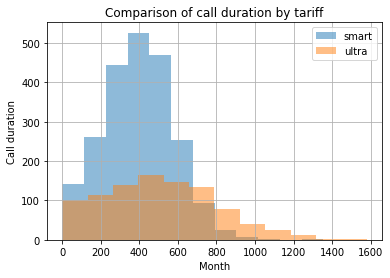

In [7]:
calls_plot = mean_smart.plot(kind='hist', x = 'month', y = 'duration', alpha=0.5, bins=12, label = 'smart')
comparison_call_duration_graph = mean_ultra.plot(kind='hist', x = 'month', y = 'duration', alpha=0.5, bins=12, label = 'ultra', ax=calls_plot, grid = True, legend = True)
comparison_call_duration_graph.set(xlabel='Month', ylabel='Call duration', title='Сomparison of call duration by tariff')


[Text(0, 0.5, 'Sms count'),
 Text(0.5, 0, 'Month'),
 Text(0.5, 1.0, 'Сomparison of sms count by tariff')]

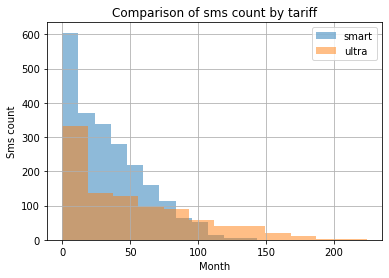

In [8]:
sms_plot = mean_smart.plot(kind='hist', x = 'month', y = 'sms', alpha=0.5, bins=12, label = 'smart')
comparison_sms_graph = mean_ultra.plot(kind='hist', x = 'month', y = 'sms', alpha=0.5, bins=12, label = 'ultra', ax=sms_plot, grid = True, legend = True)
comparison_sms_graph.set(xlabel='Month', ylabel='Sms count', title='Сomparison of sms count by tariff')

[Text(0, 0.5, 'Mb used'),
 Text(0.5, 0, 'Month'),
 Text(0.5, 1.0, 'Сomparison of mb used by tariff')]

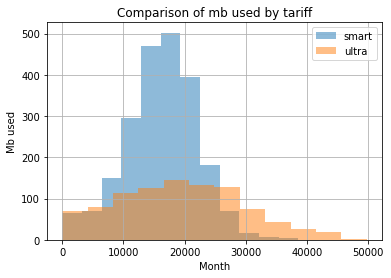

In [9]:
mb_plot = mean_smart.plot(kind='hist', x = 'month', y = 'mb_used', alpha=0.5, bins=12, label = 'smart')
comparison_mb_graph = mean_ultra.plot(kind='hist', x = 'month', y = 'mb_used', alpha=0.5, bins=12, label = 'ultra', ax=mb_plot, grid = True, legend = True)
comparison_mb_graph.set(xlabel='Month', ylabel='Mb used', title='Сomparison of mb used by tariff')

### Вывод 

Изучение поведения пользователей тарифов «Смарт»:
* Звонки. Нижний «ус» упирается в 0 - минимальное значение. Верхний заканчивается около 906. Это ориентировочная граница нормального размаха. Всё, что лежит за ней, считается выбросом. Более высокие значения представлены точками, таких выбросов у нас не много. Медиана не стремится к длинному хвосту высоких значений. Стандартное отклонение позволяет определить, насколько значения однородны. В нашем случае стандартное отклонение довольно велико, а значит в наборе данных имеются выбросы. Среднее значение (395) и медиана (399) совпадают. Дисперсия составила 32038,2. Распределение нормальное. Пользователи тарифа "Смарт" в среднем разговаривают по телефону 399 минут в месяц.
* Смс. Нижний «ус» упирается в 0 - минимальное значение. Верхний заканчивается около 114. Это ориентировочная граница нормального размаха. Всё, что лежит за ней, считается выбросом. Более высокие значения представлены точками, таких выбросов у нас не очень много. И всё же значения, которые отсёк верхний «ус» — редкие. Видно, насколько медиана не стремится к длинному хвосту высоких значений. Стандартное отклонение довольно велико, а значит в наборе данных имеются выбросы. Среднее значение (33) и медиана (28) близки. Дисперсия составила 798,2. Распределение смещено влево (распределение Пуассона). Пользователи тарифа "Смарт" в среднем отправляют 28 смсок в месяц.
* Мобильный интернет. Нижний «ус» упирается в 0 - минимальное значение. Верхний заканчивается около 31 000. Это ориентировочная граница нормального размаха. Всё, что лежит за ней, считается выбросом. Более высокие значения представлены точками, таких выбросов у нас не много. И всё же значения, которые отсёк верхний «ус» — редкие. В нашем случае стандартное отклонение довольно велико - в наборе данных имеются выбросы. Среднее значение (16209) и медиана (16504) практически совпадают. Дисперсия составила 34514864,8. Распределение нормальное. Пользователи тарифа "Смарт" в среднем используют 16,1 Гб мобильного интернета в месяц.

Изучение поведения пользователей тарифов «Ультра»:
* Звонки. Нижний «ус» упирается в 0 - минимальное значение. Верхний заканчивается около 1337,8. Это ориентировочная граница нормального размаха. Всё, что лежит за ней, считается выбросом. Более высокие значения представлены точками, таких выбросов у нас очень мало. Видно, насколько медиана не стремится к длинному хвосту высоких значений. В нашем случае стандартное отклонение не велико, а значит данные более-менее однородны. Среднее значение (514,8) и медиана (497,8) совпадают. Дисперсия составила 83914,3. Распределение нормальное. Пользователи тарифа "Ультра" в среднем разговаривают по телефону 498 минут в месяц.
* Смс. Нижний «ус» упирается в 0 - минимальное значение. Верхний заканчивается около 191. Это ориентировочная граница нормального размаха. Всё, что лежит за ней, считается выбросом. Более высокие значения представлены точками, таких выбросов у нас очень мало. Видно, насколько медиана не стремится к длинному хвосту высоких значений.  В нашем случае стандартное отклонение довольно велико, а значит в наборе данных имеются выбросы. Среднее значение (49) и медиана (39) отличаются. Дисперсия составила 2196,4. Распределение смещено влево (распределение Пуассона). Пользователи тарифа "Смарт" в среднем отправляют 39 смсок в месяц.
* Мобильный интернет. Нижний «ус» упирается в 0 - минимальное значение. Верхний заканчивается около 48351. Это ориентировочная граница нормального размаха. Всё, что лежит за ней, считается выбросом. Более высокие значения представлены точками, таких выбросов у нас очень мало. Видно, насколько медиана не стремится к длинному хвосту высоких значений. В нашем случае стандартное отклонение довольно велико, а значит в наборе данных имеются серьёзные аномалии или выбросы. Среднее значение (19462,5) и медиана (19352,5) совпадают. Дисперсия составила 102444655,3. Распределение нормальное. Пользователи тарифа "Смарт" в среднем используют 18,9 Гб мобильного интернета в месяц.


# Шаг 4. Проверка гипотез

* Формулирование нулевой и альтернативной гипотезы. 
* Выбор и обоснование критерия для проверки гипотез.

In [10]:
fig = px.histogram(mean_smart, x = 'monthly_cash', marginal = 'box', title = 'Распределение '+ 'monthly_cash')
fig.show()
print(mean_smart['monthly_cash'].describe())
variance_cash_smart = np.var(mean_smart['monthly_cash'])
print(variance_cash_smart)

count    2225.000000
mean     1198.388237
std       768.464983
min       550.000000
25%       550.000000
50%       925.195312
75%      1605.984375
max      6543.882812
Name: monthly_cash, dtype: float64
590273.02006809


In [11]:
fig = px.histogram(mean_ultra, x = 'monthly_cash', marginal = 'box', title = 'Распределение '+ 'monthly_cash')
fig.show()
print(mean_ultra['monthly_cash'].describe())
variance_cash_ultra = np.var(mean_ultra['monthly_cash'])
print(variance_cash_ultra) 

count     957.000000
mean     2060.133749
std       357.041345
min      1950.000000
25%      1950.000000
50%      1950.000000
75%      1950.000000
max      4737.011719
Name: monthly_cash, dtype: float64
127345.31539555396


In [12]:
from scipy import stats as st
sample_1 = mean_smart['monthly_cash']
sample_2 = mean_ultra['monthly_cash']
# H0 = средние выручки пользователей тарифов «Ультра» и «Смарт» равны между собой
# H1 = средние выручки пользователей тарифов «Ультра» и «Смарт» не равны между собой

alpha = .05 # критический уровень статистической значимости
            # если p-value окажется меньше него - отвергнем гипотезу

results = st.ttest_ind(
    sample_1, 
    sample_2, equal_var = False)

print('p-значение:', results.pvalue)

if (results.pvalue < alpha):
    print("Отвергаем нулевую гипотезу")
else:
    print("Не получилось отвергнуть нулевую гипотезу") 

p-значение: 1.9743e-320
Отвергаем нулевую гипотезу


In [13]:
mean_moskva = my_big_data.query('city == "Москва"')
mean_ne_moskva = my_big_data.query('city != "Москва"')
sample_1 = mean_moskva['monthly_cash']
sample_2 = mean_ne_moskva['monthly_cash']
# H0 = средние выручки пользователей из Москвы равны выручкам пользователей из других регионов
# H1 = средние выручки пользователей из Москвы не равны выручкам пользователей из других регионов

alpha = .05 # критический уровень статистической значимости
            # если p-value окажется меньше него - отвергнем гипотезу

results = st.ttest_ind(
    sample_1, 
    sample_2, equal_var = False)

print('p-значение:', results.pvalue)

if (results.pvalue < alpha):
    print("Отвергаем нулевую гипотезу")
else:
    print("Не получилось отвергнуть нулевую гипотезу") 

p-значение: 0.3201767733278199
Не получилось отвергнуть нулевую гипотезу


### Вывод 

* H₀ всегда формулируется так, чтобы использовать знак равенства. Исходя из H₀ формулируется альтернативная гипотеза H₁. Например, H₀ = средние выручки пользователей тарифов «Ультра» и «Смарт» равны. Тогда H₁ = средние выручки пользователей тарифов «Ультра» и «Смарт» не равны между собой.
* Для проверки гипотезы о равенстве среднего двух генеральных совокупностей по взятым из них выборкам, применили метод scipy.stats.ttest_ind(). 
* В результате проверки гипотез установили, что средняя выручка пользователей тарифов «Ультра» и «Смарт» достоверно различается.
* В результате проверки гипотез установили, что средняя выручка пользователей из Москвы не отличается от выручки пользователей из других регионов.

# Шаг 5. Общий вывод 

* Пользователи тарифа "Смарт" в среднем разговаривают по телефону 399 минут в месяц; отправляют 28 смсок в месяц и используют 16,1 Гб мобильного интернета в месяц. Усредненная ежемесячная выручка с пользователей тарифа "Смарт" составляет 1198 рублей. 
* Пользователи тарифа "Ультра" в среднем разговаривают по телефону 498 минут в месяц; отправляют 39 смсок в месяц и используют 18,9 Гб мобильного интернета в месяц. Усредненная ежемесячная выручка с пользователей тарифа "Ультра" составляет 2061 рублей.
* Пользователи тарифа "Ультра" чаще разговаривают по телефону, отправляют больше смс-сообщений и используют больше мобильного интернета в месяц, чем пользователи тарифа "Смарт". Тариф "Ультра" приносит почти в 2 раза больше выручки, чем тариф "Смарт".